In [1]:
import folium
import geopandas as gpd
import networkx as nx
import numpy as np
import pandas as pd
import re
import seaborn as sns
from folium import Choropleth, Marker
from folium.plugins import HeatMap, MarkerCluster
from matplotlib import pyplot as plt
from scipy import stats as ss
from sklearn.preprocessing import LabelEncoder

In [2]:
conflicts_file_path = "../Dados/Ukraine_conflicts.csv"

df_conflicts = pd.read_csv(conflicts_file_path)

display(df_conflicts)

,data_id,iso,event_id_cnty,event_id_no_cnty,event_date,year,time_precision,event_type,sub_event_type,actor1,...,location,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,timestamp,iso3
0,9415087,804,UKR64033,64033,15 July 2022,2022,1,Explosions/Remote violence,Shelling/artillery/missile attack,Military Forces of Ukraine (2019-),...,Melitopol,46.8489,35.3653,1,061.ua,Subnational,"On 15 July 2022, Ukrainian forces shelled Meli...",0,1658249347,UKR
1,9415107,804,UKR63274,63274,15 July 2022,2022,1,Strategic developments,Disrupted weapons use,Military Forces of Ukraine (2019-),...,Bila Tserkva,49.8094,30.1121,2,24 Channel,National,"Interception: On 15 July 2022, Ukrainian air d...",0,1658249347,UKR
2,9415126,804,UKR63181,63181,15 July 2022,2022,1,Explosions/Remote violence,Air/drone strike,Military Forces of Russia (2000-) Air Force,...,Dnipro,48.4593,35.0386,1,24 Channel,National,"On 15 July 2022, Russian aircraft over the Cas...",0,1658249347,UKR
3,9415131,804,UKR63344,63344,15 July 2022,2022,1,Explosions/Remote violence,Shelling/artillery/missile attack,Military Forces of Russia (2000-),...,Slovyansk,48.8533,37.6065,1,24 Channel,National,"On 15 July 2022, Russian forces shelled Slovya...",1,1658249347,UKR
4,9415142,804,UKR63275,63275,15 July 2022,2022,1,Strategic developments,Disrupted weapons use,Military Forces of Ukraine (2019-),...,Odesa,46.4639,30.7386,3,24 Channel,National,"Interception: On 15 July 2022, Ukrainian air d...",0,1658249347,UKR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39386,9092833,804,UKR23175,23175,16 July 2019,2019,1,Violence against civilians,Attack,Military Forces of Ukraine (2014-2019),...,Odesa,46.4639,30.7386,1,24 Channel; Novoye Vremya Ukraine,National,"On 16 July 2019, a man was shot in his leg by ...",0,1649875489,UKR
39387,9092834,804,UKR23176,23176,16 July 2019,2019,1,Protests,Peaceful protest,Protesters (Ukraine),...,Kyiv - Shevchenkivskyi,50.4646,30.4655,1,Novoye Vremya Ukraine; Right Sector; Svoboda; ...,Other-National,"On 16 July 2019, several dozen people, includi...",0,1649875489,UKR
39388,9092835,804,UKR23560,23560,16 July 2019,2019,1,Protests,Peaceful protest,Protesters (Ukraine),...,Odesa,46.4639,30.7386,1,Sayt Goroda Odessy,Subnational,"On 16 July 2019, people attended a demonstrati...",0,1649875489,UKR
39389,9175245,804,UKR23178,23178,16 July 2019,2019,1,Battles,Armed clash,NAF: United Armed Forces of Novorossiya,...,Novotroitske,47.7158,37.5919,2,JFO HQ press centre; Ministry of Defence of Uk...,Other,"On 16 July 2019, the NAF rebel forces fired gr...",0,1651165035,UKR


In [3]:
def string_list_sep(string_list: list) -> list: 
    """
    Função auxiliar para separar dar espaço em strings na lista
    """
    string_sep = lambda x: x.replace(' ', '\n').replace('/', '/\n')
    
    return list(map(string_sep, string_list))

In [4]:
df_2022 = df_conflicts[df_conflicts['year'] >= 2022].drop_duplicates().reset_index()

In [5]:
attrs = ['event_date', 'year', 'event_type', 'sub_event_type', 'fatalities', 'location', 'latitude', 'longitude']

df_conflicts_2022 = df_2022[attrs]

display(df_conflicts_2022)

,event_date,year,event_type,sub_event_type,fatalities,location,latitude,longitude
0,15 July 2022,2022,Explosions/Remote violence,Shelling/artillery/missile attack,0,Melitopol,46.8489,35.3653
1,15 July 2022,2022,Strategic developments,Disrupted weapons use,0,Bila Tserkva,49.8094,30.1121
2,15 July 2022,2022,Explosions/Remote violence,Air/drone strike,0,Dnipro,48.4593,35.0386
3,15 July 2022,2022,Explosions/Remote violence,Shelling/artillery/missile attack,1,Slovyansk,48.8533,37.6065
4,15 July 2022,2022,Strategic developments,Disrupted weapons use,0,Odesa,46.4639,30.7386
...,...,...,...,...,...,...,...,...
13450,01 January 2022,2022,Protests,Peaceful protest,0,Kryvyi Rih,47.9093,33.3933
13451,01 January 2022,2022,Protests,Peaceful protest,0,Lviv,49.8407,24.0305
13452,01 January 2022,2022,Protests,Peaceful protest,0,Kyiv,50.4496,30.5224
13453,01 January 2022,2022,Protests,Peaceful protest,0,Odesa,46.4639,30.7386


In [6]:
df_subevent_type = df_conflicts_2022.groupby(['event_type', 'sub_event_type'])[['fatalities']].sum().reset_index()

display(df_subevent_type)

,event_type,sub_event_type,fatalities
0,Battles,Armed clash,5580
1,Battles,Government regains territory,56
2,Battles,Non-state actor overtakes territory,44
3,Explosions/Remote violence,Air/drone strike,1533
4,Explosions/Remote violence,Grenade,6
5,Explosions/Remote violence,Remote explosive/landmine/IED,96
6,Explosions/Remote violence,Shelling/artillery/missile attack,3277
7,Protests,Excessive force against protesters,4
8,Protests,Peaceful protest,0
9,Protests,Protest with intervention,0


In [7]:
df_event_type = df_subevent_type.groupby('event_type')[['fatalities']].sum().reset_index()

display(df_event_type)

,event_type,fatalities
0,Battles,5680
1,Explosions/Remote violence,4912
2,Protests,4
3,Riots,0
4,Strategic developments,0
5,Violence against civilians,971


In [8]:
aux_subevent_fatal = df_subevent_type[df_subevent_type['fatalities'] > 0]
aux_event_fatal = df_event_type[df_event_type['fatalities'] > 0]

events_list = string_list_sep(aux_event_fatal.event_type.tolist())
fatal_per_event_list = aux_event_fatal.fatalities.tolist()

events_fromsub_list = string_list_sep(aux_subevent_fatal.event_type.tolist())
subevents_list = string_list_sep(aux_subevent_fatal.sub_event_type.tolist())
fatal_per_subevent_list = aux_subevent_fatal.fatalities.tolist()

In [9]:
fatalities_graph = nx.Graph()

n_subevents = len(subevents_list)
n_events = len(events_list)

root = "Ukraine Fatalities\nin 2022"

pos = {root: (n_subevents//2, 6)}

In [10]:
for i in range(n_subevents):
    node = events_fromsub_list[i]
    leaf = subevents_list[i]
    
    fatalities_graph.add_edge(node, leaf, weight = fatal_per_subevent_list[i])
    
    pos[leaf] = (i, 1 - i%(n_events - 1))

for i in range(n_events):
    node = events_list[i]
    
    fatalities_graph.add_edge(root, node, weight = fatal_per_event_list[i])
    
    pos[node] = (i*2 + n_subevents//n_events, 4 - i%2)

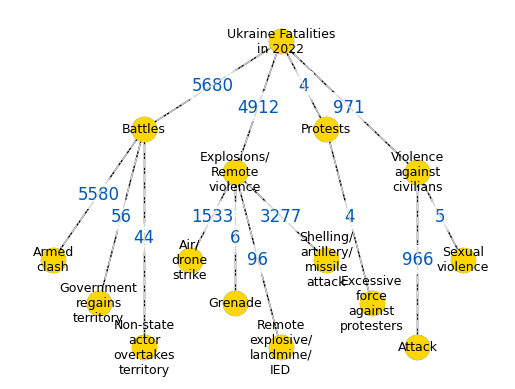

In [11]:
nx.draw_networkx(fatalities_graph, pos = pos, with_labels = True, font_size = 9)

nx.draw_networkx_edge_labels(fatalities_graph, 
                             pos = pos, 
                             edge_labels = nx.get_edge_attributes(fatalities_graph, 'weight'), 
                             rotate = False, 
                             font_size = 12,
                             font_color = '#0057b7',
                             alpha = 1
                            )

nx.draw_networkx_nodes(fatalities_graph, 
                       pos = pos,
                       node_color = '#ffd700'
                      )

nx.draw_networkx_edges(fatalities_graph, 
                       pos = pos,
                       style = '-.',
                       edge_color = 'LightGray'
                      )

plt.axis("off")
plt.show()

In [12]:
df_fatalities_per_area = df_conflicts_2022.groupby(['location', 'latitude', 'longitude'])[['fatalities']].sum()

df_fatalities_per_area = df_fatalities_per_area[df_fatalities_per_area['fatalities'] > 0].reset_index()

display(df_fatalities_per_area)

,location,latitude,longitude,fatalities
0,Adamivka,48.9430,37.4481,2
1,Andriivka,47.1761,33.0463,10
2,Antopil,50.5998,26.4405,9
3,Apostolove,47.6600,33.7137,4
4,Avdiivka,48.1394,37.7497,97
...,...,...,...,...
480,Zolochiv,50.2799,35.9818,23
481,Zolote,48.6926,38.5145,23
482,Zolote-5,48.6719,38.5600,2
483,Zorya,47.2958,37.6081,2


In [13]:
fatalities_map = folium.Map(location = [47.8, 31], tiles='cartodbpositron', zoom_start=6)

mc = MarkerCluster()

for idx, row in df_fatalities_per_area.iterrows():
    if not np.isnan(row['latitude']) and not np.isnan(row['longitude']):
        for i in range(row['fatalities']):
            mc.add_child(Marker([row['latitude'], row['longitude']]))

fatalities_map.add_child(mc)
        
display(fatalities_map)

In [14]:
fatalities_heatmap_map = folium.Map(location = [47.8, 31], tiles='cartodbpositron', zoom_start=6)

mc = MarkerCluster()

for idx, row in df_fatalities_per_area.iterrows():
    if not np.isnan(row['latitude']) and not np.isnan(row['longitude']):
        for i in range(row['fatalities']):
            mc.add_child(Marker([row['latitude'], row['longitude']]))

fatalities_heatmap_map.add_child(mc)

HeatMap(data = df_fatalities_per_area[['latitude', 'longitude']], radius = 15).add_to(fatalities_heatmap_map)
        
display(fatalities_heatmap_map)

In [15]:
attacks_map = folium.Map(location = [47.8, 31], tiles='cartodbpositron', zoom_start=6)

mc = MarkerCluster()

for idx, row in df_conflicts_2022.iterrows():
        if not np.isnan(row['latitude']) and not np.isnan(row['longitude']):
            fatal = (row['fatalities'] > 0)
            icon_type, icon_color = ('star', 'red') if fatal else ('flag', 'green')
            date = row['event_date']
            ev_type = row['event_type']
            fatalities = row['fatalities']
            h = 100
            
            message = f"<b> - Date = {date}</b><br> - Type = {ev_type}"
            
            if fatal:
                message += f"<br> - Fatalities = {fatalities}"
                h += 20
            
            iframe = folium.IFrame(message, width = 180, height = h)
            
            popup = folium.Popup(iframe, max_width = 180)
            
            mc.add_child(Marker([row['latitude'], row['longitude']], 
                                popup = popup,
                                icon = folium.Icon(color = icon_color, icon = icon_type, prefix = 'fa')
                               )
                        )
            
                                
attacks_map.add_child(mc)

display(attacks_map)

In [16]:
fatalities_features = ['fatalities', 'event_type', 'sub_event_type', 'location', 'event_date']

df_fatal = df_conflicts_2022[fatalities_features]

display(df_fatal)

,fatalities,event_type,sub_event_type,location,event_date
0,0,Explosions/Remote violence,Shelling/artillery/missile attack,Melitopol,15 July 2022
1,0,Strategic developments,Disrupted weapons use,Bila Tserkva,15 July 2022
2,0,Explosions/Remote violence,Air/drone strike,Dnipro,15 July 2022
3,1,Explosions/Remote violence,Shelling/artillery/missile attack,Slovyansk,15 July 2022
4,0,Strategic developments,Disrupted weapons use,Odesa,15 July 2022
...,...,...,...,...,...
13450,0,Protests,Peaceful protest,Kryvyi Rih,01 January 2022
13451,0,Protests,Peaceful protest,Lviv,01 January 2022
13452,0,Protests,Peaceful protest,Kyiv,01 January 2022
13453,0,Protests,Peaceful protest,Odesa,01 January 2022


In [17]:
df_attrs = df_2022.copy()

df_attrs = df_attrs[['event_date', 'event_type', 'sub_event_type', 'actor1', 'assoc_actor_1',
       'inter1', 'actor2', 'assoc_actor_2', 'inter2', 'interaction', 'admin1',
       'admin2', 'admin3', 'location', 'latitude', 'longitude', 'fatalities',
       'timestamp']]

In [18]:
cols_corr = df_attrs.columns

print(cols_corr)

Index(['event_date', 'event_type', 'sub_event_type', 'actor1', 'assoc_actor_1',
       'inter1', 'actor2', 'assoc_actor_2', 'inter2', 'interaction', 'admin1',
       'admin2', 'admin3', 'location', 'latitude', 'longitude', 'fatalities',
       'timestamp'],
      dtype='object')


In [19]:
def cramers_v(confusion_matrix):
    chi2 = ss.chi2_contingency(confusion_matrix, lambda_ = 'pearson')[0]
    n = confusion_matrix.sum()
    
    phi2 = chi2 / n
    
    r, k = confusion_matrix.shape
    
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

In [20]:
cnf_matrix = list()

n = len(cols_corr)

for i in range(n):
    row = list()
    for j in range(n):
        val = pd.crosstab(df_attrs[cols_corr[i]], df_attrs[cols_corr[j]])
        row.append(cramers_v(val.values))
    cnf_matrix.append(row)

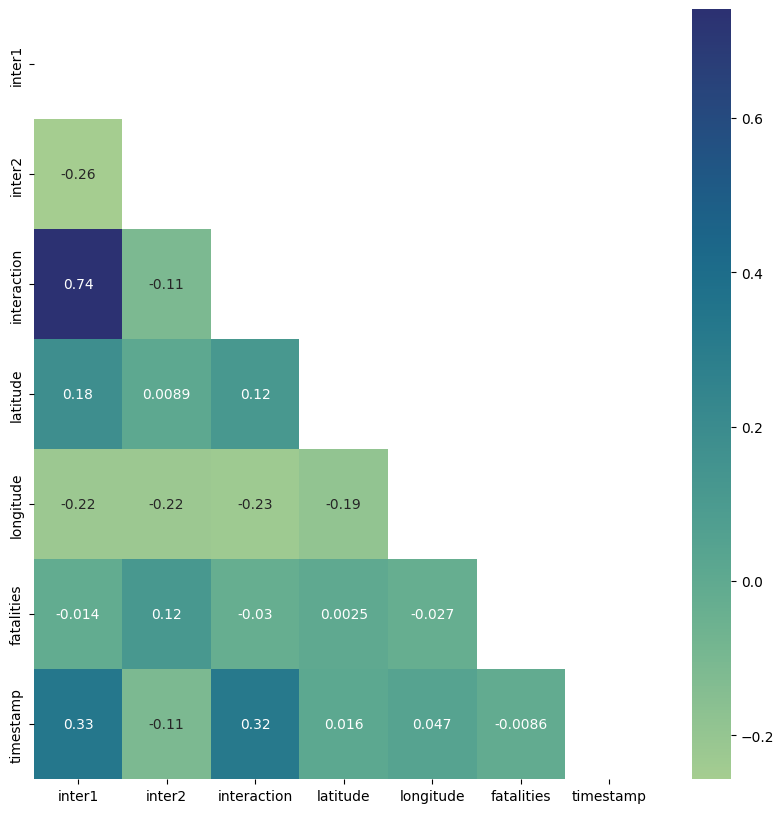

In [21]:
aux = df_attrs.corr(method = 'pearson')

aux2 = np.matrix(cnf_matrix)

mask = np.triu(np.ones_like(aux))

fig, ax = plt.subplots(figsize = (10, 10))
ax = sns.heatmap(aux, cmap = 'crest', annot = True, mask = mask)

plt.show()

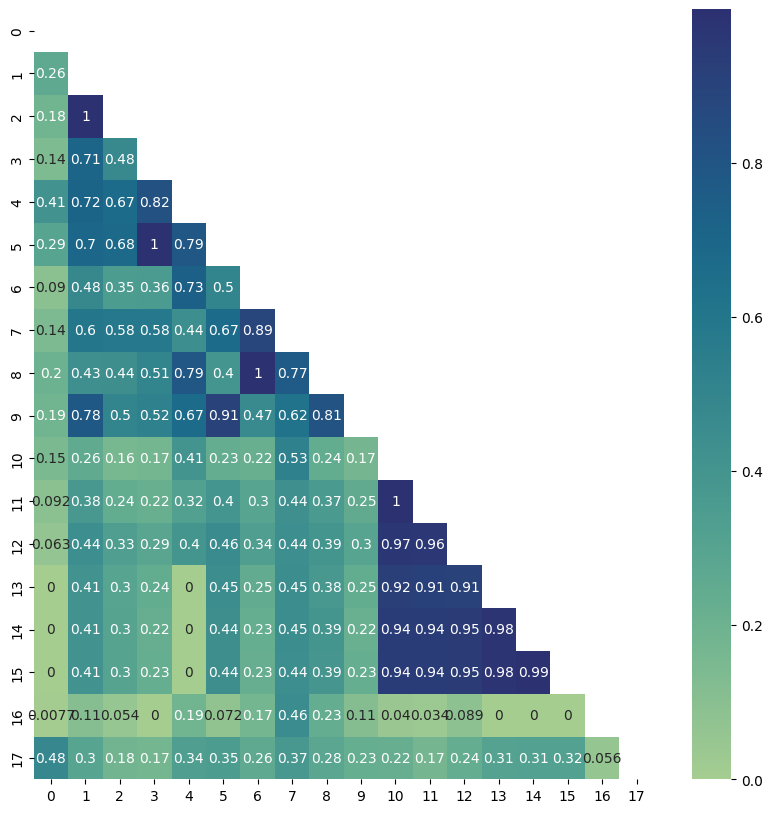

In [22]:
aux_matrix = np.matrix(cnf_matrix)

mask = np.triu(np.ones_like(aux_matrix))

fig, ax = plt.subplots(figsize = (10, 10))
ax = sns.heatmap(aux_matrix, cmap = 'crest', annot = True, mask = mask)

plt.show()

In [23]:
for i, row in enumerate(cnf_matrix):
    print(f"{cols_corr[i]} = {np.mean(row)}")

event_date = 0.20519301370615256
event_type = 0.522138491746851
sub_event_type = 0.4307197078765888
actor1 = 0.4260404049673736
assoc_actor_1 = 0.4828030556238224
inter1 = 0.5432533306095602
actor2 = 0.4370793472418433
assoc_actor_2 = 0.5481019296696147
inter2 = 0.5009473340578735
interaction = 0.4567882996588222
admin1 = 0.4761981357719481
admin2 = 0.49792006888101703
admin3 = 0.5284276295186952
location = 0.4850697858525733
latitude = 0.4875142814647186
longitude = 0.4881579887809693
fatalities = 0.1459388114948966
timestamp = 0.31033393028018974


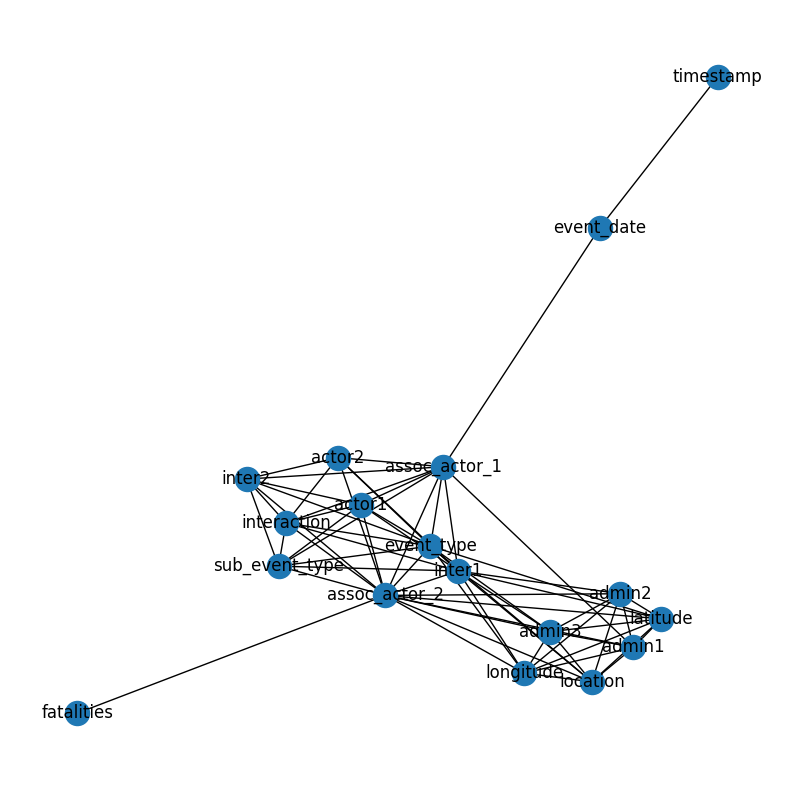

In [24]:
attr_graph = nx.Graph()

threshold = 0.4

node_colors = []

for i, row in enumerate(cnf_matrix):     
    for j, val in enumerate(row):
        if i != j:
            if val > threshold:
                attr_graph.add_edge(cols_corr[i], cols_corr[j], weight = np.round(val, decimals = 2))
        else:
            attr_graph.add_node(cols_corr[i])
                  

plt.figure(1, figsize = (10,10)) 

nx.draw_networkx(attr_graph, with_labels = 1)

plt.axis("off")
plt.show()

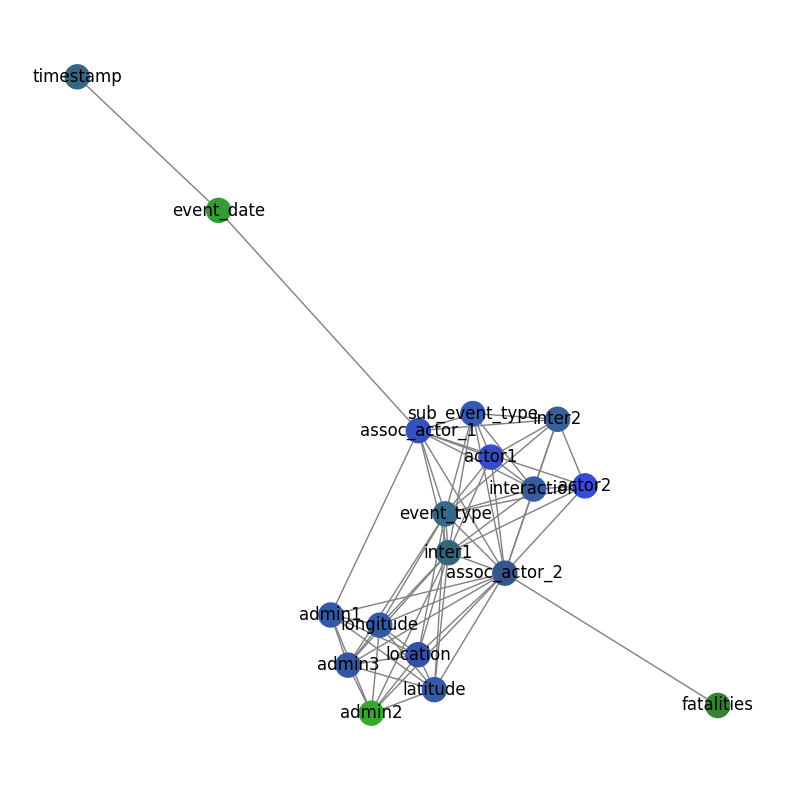

In [25]:
attr_graph = nx.Graph()

threshold = 0.4

node_colors = []

for i, row in enumerate(cnf_matrix):
    green_shades = 0xbf
    blue_shades = 0x24
     
    for j, val in enumerate(row):
        if i != j:
            if val > threshold:
                attr_graph.add_edge(cols_corr[i], cols_corr[j], weight = np.round(val, decimals = 2))
                blue_shades += (val)*22*(threshold + 0.6)
            green_shades -= (val)*13
        else:
            attr_graph.add_node(cols_corr[i])
            
    green_shades = int(green_shades)                
    blue_shades = int(blue_shades)

    node_colors.append('#35{0:x}{1:x}'.format(green_shades, blue_shades))
                

plt.figure(1, figsize = (10,10)) 

nx.draw_networkx(attr_graph, 
                 with_labels = True, 
                 node_color = node_colors,
                 edge_color = 'Gray'
                )

plt.axis("off")
plt.show()

In [26]:
for idx, col in enumerate(cols_corr):
    print(f'{idx} - {col}')

0 - event_date
1 - event_type
2 - sub_event_type
3 - actor1
4 - assoc_actor_1
5 - inter1
6 - actor2
7 - assoc_actor_2
8 - inter2
9 - interaction
10 - admin1
11 - admin2
12 - admin3
13 - location
14 - latitude
15 - longitude
16 - fatalities
17 - timestamp


In [27]:
df_attrs_labels = df_attrs.copy()

display(df_attrs_labels)

,event_date,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,interaction,admin1,admin2,admin3,location,latitude,longitude,fatalities,timestamp
0,15 July 2022,Explosions/Remote violence,Shelling/artillery/missile attack,Military Forces of Ukraine (2019-),NaN,1,NaN,NaN,0,10,Zaporizhia,Melitopolskyi,Melitopolska,Melitopol,46.8489,35.3653,0,1658249347
1,15 July 2022,Strategic developments,Disrupted weapons use,Military Forces of Ukraine (2019-),NaN,1,Military Forces of Russia (2000-),NaN,8,18,Kyiv,Bilotserkivskyi,Bilotserkivska,Bila Tserkva,49.8094,30.1121,0,1658249347
2,15 July 2022,Explosions/Remote violence,Air/drone strike,Military Forces of Russia (2000-) Air Force,NaN,8,NaN,NaN,0,80,Dnipropetrovsk,Dniprovskyi,Dniprovska,Dnipro,48.4593,35.0386,0,1658249347
3,15 July 2022,Explosions/Remote violence,Shelling/artillery/missile attack,Military Forces of Russia (2000-),NaN,8,Civilians (Ukraine),NaN,7,78,Donetsk,Kramatorskyi,Slovianska,Slovyansk,48.8533,37.6065,1,1658249347
4,15 July 2022,Strategic developments,Disrupted weapons use,Military Forces of Ukraine (2019-),NaN,1,Military Forces of Russia (2000-),NaN,8,18,Odesa,Odeskyi,Odeska,Odesa,46.4639,30.7386,0,1658249347
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13450,01 January 2022,Protests,Peaceful protest,Protesters (Ukraine),Svoboda,6,NaN,NaN,0,60,Dnipropetrovsk,Kryvorizkyi,Kryvorizka,Kryvyi Rih,47.9093,33.3933,0,1641935017
13451,01 January 2022,Protests,Peaceful protest,Protesters (Ukraine),Svoboda,6,NaN,NaN,0,60,Lviv,Lvivskyi,Lvivska,Lviv,49.8407,24.0305,0,1642167859
13452,01 January 2022,Protests,Peaceful protest,Protesters (Ukraine),Former Military Forces of Ukraine (2019-); Rig...,6,NaN,NaN,0,60,Kyiv City,Kyiv,NaN,Kyiv,50.4496,30.5224,0,1646184493
13453,01 January 2022,Protests,Peaceful protest,Protesters (Ukraine),NaN,6,NaN,NaN,0,60,Odesa,Odeskyi,Odeska,Odesa,46.4639,30.7386,0,1646184497


In [28]:
labelencoder = LabelEncoder()

cat_cols = ['event_date', 'event_type', 'sub_event_type', 'actor1', 'assoc_actor_1', 
            'actor2', 'assoc_actor_2', 'admin1', 'admin2', 'admin3', 'location']

for cat_col in cat_cols:
    df_attrs_labels[cat_col] = labelencoder.fit_transform(df_attrs_labels[cat_col])

display(df_attrs_labels)

,event_date,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,interaction,admin1,admin2,admin3,location,latitude,longitude,fatalities,timestamp
0,101,1,21,16,77,1,41,105,0,10,24,61,209,569,46.8489,35.3653,0,1658249347
1,101,4,7,16,77,1,16,105,8,18,11,10,29,64,49.8094,30.1121,0,1658249347
2,101,1,2,12,77,8,41,105,0,80,4,24,81,182,48.4593,35.0386,0,1658249347
3,101,1,21,11,77,8,10,105,7,78,5,47,350,1026,48.8533,37.6065,1,1658249347
4,101,4,7,16,77,1,16,105,8,18,16,72,273,752,46.4639,30.7386,0,1658249347
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13450,2,2,17,34,67,6,41,105,0,60,4,52,170,440,47.9093,33.3933,0,1641935017
13451,2,2,17,34,67,6,41,105,0,60,14,59,192,515,49.8407,24.0305,0,1642167859
13452,2,2,17,34,16,6,41,105,0,60,12,54,465,457,50.4496,30.5224,0,1646184493
13453,2,2,17,34,77,6,41,105,0,60,16,72,273,752,46.4639,30.7386,0,1646184497


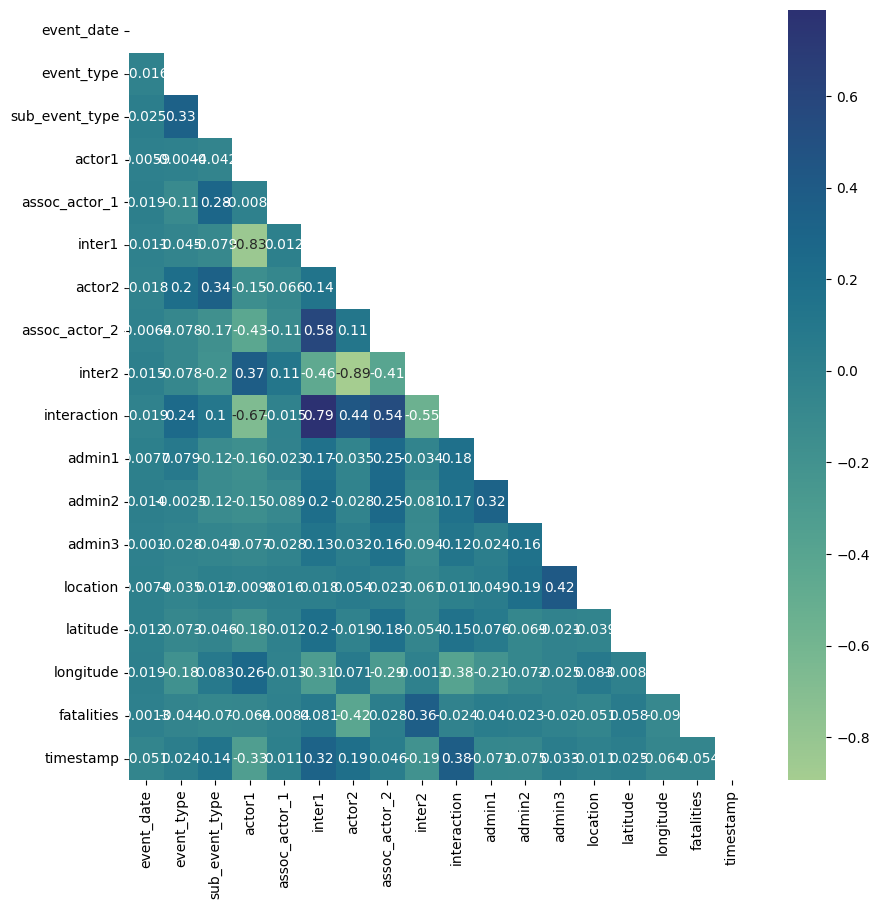

In [29]:
corr_matrix = df_attrs_labels.corr(method = 'spearman')

aux_matrix = np.matrix(corr_matrix)

mask = np.triu(np.ones_like(aux_matrix))

fig, ax = plt.subplots(figsize = (10, 10))
ax = sns.heatmap(corr_matrix, cmap = 'crest', annot = True, mask = mask)

plt.show()

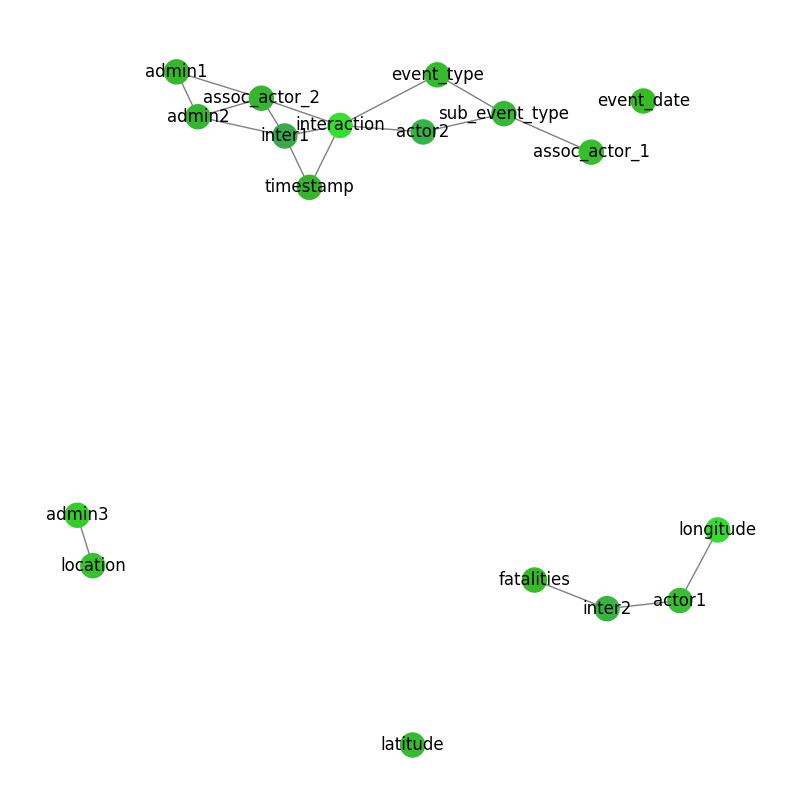

In [30]:
attr_graph = nx.Graph()

threshold = 0.2

node_colors = []

for i, col in enumerate(corr_matrix):
    green_shades = 0xbf
    blue_shades = 0x24
     
    for j, val in enumerate(corr_matrix[col]):
        if i != j:
            if val > threshold:
                attr_graph.add_edge(cols_corr[i], cols_corr[j], weight = np.round(val, decimals = 2))
                blue_shades += (val)*22*(threshold + 0.6)
            green_shades -= (val)*13
        else:
            attr_graph.add_node(cols_corr[i])
            
    green_shades = int(green_shades)                
    blue_shades = int(blue_shades)

    node_colors.append('#35{0:x}{1:x}'.format(green_shades, blue_shades))
                

plt.figure(1, figsize = (10,10)) 

nx.draw_networkx(attr_graph, 
                 with_labels = True, 
                 node_color = node_colors,
                 edge_color = 'Gray'
                )

plt.axis("off")
plt.show()

In [31]:
attrs = ['actor1', 'assoc_actor_1', 'actor2', 'assoc_actor_2', 'location', 'interaction', 'fatalities', 'event_type']

df_conflict_actors = df_2022[attrs]

display(df_conflict_actors)

,actor1,assoc_actor_1,actor2,assoc_actor_2,location,interaction,fatalities,event_type
0,Military Forces of Ukraine (2019-),NaN,NaN,NaN,Melitopol,10,0,Explosions/Remote violence
1,Military Forces of Ukraine (2019-),NaN,Military Forces of Russia (2000-),NaN,Bila Tserkva,18,0,Strategic developments
2,Military Forces of Russia (2000-) Air Force,NaN,NaN,NaN,Dnipro,80,0,Explosions/Remote violence
3,Military Forces of Russia (2000-),NaN,Civilians (Ukraine),NaN,Slovyansk,78,1,Explosions/Remote violence
4,Military Forces of Ukraine (2019-),NaN,Military Forces of Russia (2000-),NaN,Odesa,18,0,Strategic developments
...,...,...,...,...,...,...,...,...
13450,Protesters (Ukraine),Svoboda,NaN,NaN,Kryvyi Rih,60,0,Protests
13451,Protesters (Ukraine),Svoboda,NaN,NaN,Lviv,60,0,Protests
13452,Protesters (Ukraine),Former Military Forces of Ukraine (2019-); Rig...,NaN,NaN,Kyiv,60,0,Protests
13453,Protesters (Ukraine),NaN,NaN,NaN,Odesa,60,0,Protests


In [32]:
df_actors = df_2022.groupby(['actor1', 'actor2'], dropna = False)[['fatalities']].sum()

df_actors = df_actors[df_actors['fatalities'] > 5].reset_index().fillna('Self')

display(df_actors)

,actor1,actor2,fatalities
0,Melitopol Communal Militia (Ukraine),Military Forces of Russia (2000-),103
1,Military Forces of Russia (2000-),Civilians (Ukraine),2641
2,Military Forces of Russia (2000-),Military Forces of Ukraine (2019-),2401
3,Military Forces of Russia (2000-),Military Forces of Ukraine (2019-) Air Force,10
4,Military Forces of Russia (2000-),Military Forces of Ukraine (2019-) National Guard,77
5,Military Forces of Russia (2000-),Military Forces of Ukraine (2019-) Special Ope...,13
6,Military Forces of Russia (2000-),Military Forces of Ukraine (2019-) Territorial...,27
7,Military Forces of Russia (2000-),Police Forces of Ukraine (2019-) State Border ...,7
8,Military Forces of Russia (2000-),Police Forces of Ukraine (2019-) State Emergen...,6
9,Military Forces of Russia (2000-),Self,40


In [33]:
def filter_string(string: str) -> str:
    string = string.replace('Ukraine', 'Ukr')
    string = string.replace('Military Forces', 'MF')
    string = string.replace('Police Forces', 'PF')
    string = string.replace('(', '\n(')
        
    return string

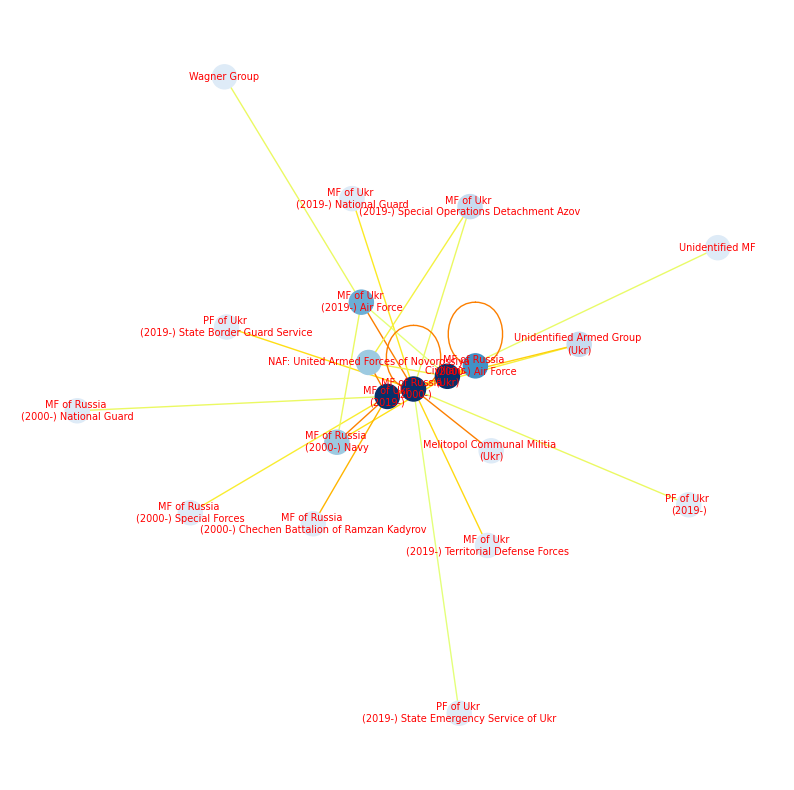

In [34]:
actors_graph = nx.Graph()

for idx, row in df_actors.iterrows():    
    actor1 = filter_string(row['actor1'])
    actor2 = filter_string(row['actor2'])
    
    actors_graph.add_node(actor1)
    
    if actor2 not in ('Self'):
        actors_graph.add_edge(actor1, actor2, weight = row['fatalities'])
    else:
        actors_graph.add_edge(actor1, actor1, weight = row['fatalities'])        
    
nodes = actors_graph.nodes()
degrees = actors_graph.degree()
edges, weights = zip(*nx.get_edge_attributes(actors_graph, 'weight').items())
edge_min = min(weights)
edge_max = (max(weights) - edge_min)//50

node_colors = np.asarray([degrees[node] for node in nodes])

plt.figure(1, figsize = (10,10)) 

nx.draw_networkx(actors_graph,
                 pos = nx.spring_layout(actors_graph),
                 with_labels = True,
                 font_size = 7,
                 font_color = 'Red',
                 node_color = node_colors,
                 cmap = plt.cm.Blues,
                 vmin = 0, vmax = 8,
                 edge_color = weights, 
                 edge_cmap = plt.cm.Wistia,
                 edge_vmin = edge_min, edge_vmax = edge_max
                )
        
plt.axis("off")
plt.show()

In [35]:
df_actors_location = df_2022.groupby(['sub_event_type', 'admin1'])[['fatalities']].sum()

df_actors_location = df_actors_location[df_actors_location['fatalities'] > 0].reset_index()

display(df_actors_location)

,sub_event_type,admin1,fatalities
0,Air/drone strike,Chernihiv,102
1,Air/drone strike,Dnipropetrovsk,14
2,Air/drone strike,Donetsk,517
3,Air/drone strike,Kharkiv,437
4,Air/drone strike,Kherson,57
...,...,...,...
79,Shelling/artillery/missile attack,Rivne,9
80,Shelling/artillery/missile attack,Sumy,107
81,Shelling/artillery/missile attack,Vinnytsia,38
82,Shelling/artillery/missile attack,Zaporizhia,195


In [36]:
def add_line(string: str) -> str:
    return string.replace('/', ',\n').replace(' ', '\n')

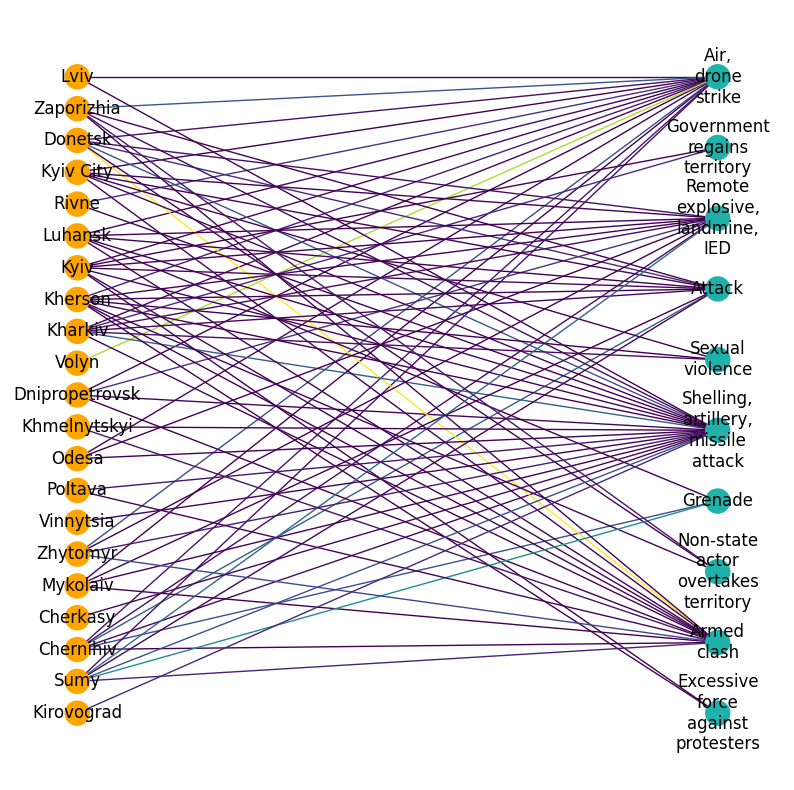

In [37]:
loc_subevent_graph = nx.Graph()

nodes_color = dict()

for idx, row in df_actors_location.iterrows():
    location = row['admin1']
    subevent = add_line(row['sub_event_type'])
    weight = row['fatalities']
    
    loc_subevent_graph.add_edge(location, subevent, weight = weight)
    
    nodes_color[location] = 'Orange'
    nodes_color[subevent] = 'LightSeaGreen'

plt.figure(1, figsize = (10,10)) 

pos = nx.bipartite_layout(loc_subevent_graph, df_actors_location['admin1'])

nx.draw_networkx(loc_subevent_graph,
                 pos = pos,
                 edge_color = df_actors_location['fatalities'],
                 edge_cmap = plt.cm.viridis,
                 node_color = nodes_color.values()
                )
    
plt.axis("off")
plt.show()